# import libraries

In [1]:
import pandas as pd
import numpy as np

# Read Data
    - data contain about 16.000 posts from facebook 
    - data in arabic language

In [9]:
sentences=pd.read_csv("data_lda.csv",sep="&",names=["data"]).dropna()

In [10]:
sentences

,data
0,#السورية للمخابز تتحدّث عن #آلية جديدة لبيع #ا...
1,#النقل خلال الاجتماع السنوي #لغرفة الملاحة الب...
2,#فرّح أهلك : خدمة في #مصر تساعد السوريين على ت...
3,#قسد تطالب بتعاون دولي لمحاكمة أسرى داعـش :
4,#نيويورك تايمز نقلا عن مسؤول #أمريكي: إسرائيل ...
...,...
16780,لكنني والله لستُ سيئة ليُصيبُني كُل هذا الحُزن...
16781,لن يكون الرئيس بشار من يحني رأسه ورأس شعبه لأح...
16782,لن يكون الرئيس بشار من يحني رأسه ورأس شعبه لأح...
16783,لو أنّ كل إنسان فعل ما بوسعه لتجميل رقعة الأرض...


In [11]:
loadedSentsCount = len(sentences)
print(">> %d sentences loaded .." % loadedSentsCount)

>> 16785 sentences loaded ..


# prepare data for word2vec model
    - split every sentence into words

In [15]:
sentences_for_model=sentences['data'].apply(str.split)

In [16]:
sentences_for_model

0        [#السورية, للمخابز, تتحدّث, عن, #آلية, جديدة, ...
1        [#النقل, خلال, الاجتماع, السنوي, #لغرفة, الملا...
2        [#فرّح, أهلك, :, خدمة, في, #مصر, تساعد, السوري...
3        [#قسد, تطالب, بتعاون, دولي, لمحاكمة, أسرى, داع...
4        [#نيويورك, تايمز, نقلا, عن, مسؤول, #أمريكي:, إ...
                               ...                        
16780    [لكنني, والله, لستُ, سيئة, ليُصيبُني, كُل, هذا...
16781    [لن, يكون, الرئيس, بشار, من, يحني, رأسه, ورأس,...
16782    [لن, يكون, الرئيس, بشار, من, يحني, رأسه, ورأس,...
16783    [لو, أنّ, كل, إنسان, فعل, ما, بوسعه, لتجميل, ر...
16784    [لورانس, ريبل, عجوز, عمره, سنة, بعد, مرور, سنة...
Name: data, Length: 16785, dtype: object

# Build word2vec model
    - initiate and fit word2vec model on our data

In [17]:
from gensim.models import Word2Vec
word2VecModel = Word2Vec(sentences_for_model, 
                 min_count=2,   # Ignore words that appear less than this
                 size=150,      # Dimensionality of word embeddings
                 workers=8,     # Number of processors (parallelisation)         
                 window=5,      # Context window for words during training
                 iter=1000)       # Number of epochs training over corpus
print(len(word2VecModel.wv.vocab))

37920


In [51]:
# import fasttext
# # model = fasttext.train_supervised(input = 'Terrorist DS.train.txt')
# ft_model = fasttext.train_unsupervised('all_data_Category.csv', model='skipgram',epoch=100,dim=150,thread=5)

In [52]:
# len(ft_model.get_words())

In [53]:
# ft_model.save_model('ft_model_JeelWithoutEmotionsWithE.bin')

In [18]:
word2VecModel.wv.vocab

{'#السورية': <gensim.models.keyedvectors.Vocab at 0x2a063d788c8>,
 'للمخابز': <gensim.models.keyedvectors.Vocab at 0x2a06762fa08>,
 'عن': <gensim.models.keyedvectors.Vocab at 0x2a06762fa88>,
 'جديدة': <gensim.models.keyedvectors.Vocab at 0x2a06762f388>,
 'لبيع': <gensim.models.keyedvectors.Vocab at 0x2a06762fb08>,
 '#الخبز': <gensim.models.keyedvectors.Vocab at 0x2a06762fb88>,
 'تدخل': <gensim.models.keyedvectors.Vocab at 0x2a06762fbc8>,
 'حيّز': <gensim.models.keyedvectors.Vocab at 0x2a06762fc08>,
 'التنفيذ': <gensim.models.keyedvectors.Vocab at 0x2a06762fa48>,
 'وتقول': <gensim.models.keyedvectors.Vocab at 0x2a06762fb48>,
 'إن': <gensim.models.keyedvectors.Vocab at 0x2a06762fc48>,
 'الهدف': <gensim.models.keyedvectors.Vocab at 0x2a06762fc88>,
 'منها': <gensim.models.keyedvectors.Vocab at 0x2a06762fcc8>,
 'ضبط': <gensim.models.keyedvectors.Vocab at 0x2a06762fd08>,
 'عمليات': <gensim.models.keyedvectors.Vocab at 0x2a06762fd48>,
 'الإنتاج': <gensim.models.keyedvectors.Vocab at 0x2a06762

In [19]:
def computeVectorsFromRaw(RawNPs, model, repLen = 150):
    import numpy as np
    # repLen word representation vector length
    VectorizedNPs = []
    for Np in RawNPs:
        vec = np.zeros(repLen)
        words = Np.split()
        Vecs = [model.wv.get_vector(word) for word in words if len(word) >= 3 and word in model.wv.vocab]
        if len(Vecs)>0:
            vec = np.sum(Vecs,axis=0)
        VectorizedNPs.append((Np, vec))
    return VectorizedNPs

In [25]:
VectorizedNPs = computeVectorsFromRaw(sentences['data'].values, word2VecModel)

In [27]:
# VectorizedNPs

In [28]:
import pandas as pd
VectorizedDf = pd.DataFrame(VectorizedNPs,columns=['NP','Vector'])
# (VectorizedDf['Vector'][22])
print(len(VectorizedDf['Vector']))
VectorizedDf

16785


,NP,Vector
0,#السورية للمخابز تتحدّث عن #آلية جديدة لبيع #ا...,"[-20.442043, -25.457739, 1.8986142, 32.182365,..."
1,#النقل خلال الاجتماع السنوي #لغرفة الملاحة الب...,"[-68.32008, -12.186775, 74.9516, 15.727449, -1..."
2,#فرّح أهلك : خدمة في #مصر تساعد السوريين على ت...,"[4.127943, 4.3054047, -4.192249, 13.488186, 5...."
3,#قسد تطالب بتعاون دولي لمحاكمة أسرى داعـش :,"[9.7222185, 1.1930907, 4.5704193, -9.360793, -..."
4,#نيويورك تايمز نقلا عن مسؤول #أمريكي: إسرائيل ...,"[18.309689, -6.423284, 8.557117, -13.469868, 3..."
...,...,...
16780,لكنني والله لستُ سيئة ليُصيبُني كُل هذا الحُزن...,"[-7.713021, 2.78691, 11.321125, -1.3516037, -4..."
16781,لن يكون الرئيس بشار من يحني رأسه ورأس شعبه لأح...,"[20.118904, -23.49189, 8.69937, -25.35953, -49..."
16782,لن يكون الرئيس بشار من يحني رأسه ورأس شعبه لأح...,"[15.678391, -3.5487623, 6.251394, -16.253807, ..."
16783,لو أنّ كل إنسان فعل ما بوسعه لتجميل رقعة الأرض...,"[7.0076566, -6.8713307, 27.538725, 2.1106982, ..."


# Reduce dimension for plotting
    -dimensionality reduction usng tsne model

In [33]:
from sklearn.manifold import TSNE
result_tsne=TSNE().fit_transform(VectorizedDf['Vector'].values.flatten().tolist())

In [35]:
tsne_df = pd.DataFrame(result_tsne, columns=['x', 'y'])
tsne_df

,x,y
0,1.855942,49.258545
1,-59.294922,-22.118244
2,14.594854,11.658897
3,0.664230,-11.847926
4,31.595295,-13.015470
...,...,...
16780,-3.832441,13.057245
16781,-68.495041,-21.406729
16782,-43.723949,3.495285
16783,-39.644634,-0.532210


# Clustering
    - cluster space word2vec

In [37]:
from sklearn.cluster import MiniBatchKMeans

In [38]:
cls = MiniBatchKMeans(n_clusters=10, random_state=1000)
cl=cls.fit_predict(VectorizedDf['Vector'].values.flatten().tolist())

C:\Users\khaled.15\AppData\Roaming\Python\Python37\site-packages\sklearn\cluster\_kmeans.py:888: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 1024 or by setting the environment variable OMP_NUM_THREADS=1
  f"MiniBatchKMeans is known to have a memory leak on "


In [39]:
tsne_df['cluster']=cl

# count in every cluster

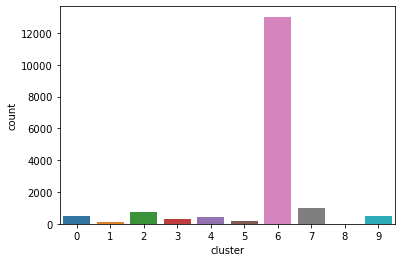

In [40]:
import seaborn as sns
sns.countplot(x='cluster',data=tsne_df)

In [41]:
tsne_df['cluster_as_string']=tsne_df['cluster'].apply(str)

In [42]:
tsne_df['words']=VectorizedDf['NP']

In [43]:
import bokeh.plotting as bp
from  bokeh.palettes import d3
from bokeh.models import mappers as bmo
from bokeh.plotting import figure, show, output_notebook
from bokeh.models import HoverTool, BoxSelectTool

output_notebook()
plot_tfidf = bp.figure(plot_width=1000, plot_height=1000, title="A map of word vectors",
    tools="pan,wheel_zoom,box_zoom,reset,hover",
    x_axis_type=None, y_axis_type=None, min_border=1)

Loading BokehJS ...

In [45]:
palette = d3['Category10'][len(tsne_df['cluster'].unique())]
color_map = bmo.CategoricalColorMapper(factors=tsne_df['cluster_as_string'].unique(),
                                   palette=palette)
plot_tfidf.scatter(x='x', y='y', source=tsne_df,color={'field': 'cluster_as_string','transform': color_map})
hover = plot_tfidf.select(dict(type=HoverTool))
hover.tooltips={"count": "@cluster_as_string","post":"@words","cluster":"@cluster_as_string"}
show(plot_tfidf)